In [127]:
import pandas as pd
import numpy as np
from xgboost import XGBRegressor, XGBClassifier
import numpy as np
from sklearn import metrics
from sklearn.model_selection import train_test_split
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
pd.set_option('display.max_rows', 500)

In [9]:
dados = pd.read_csv("data/Friday-WorkingHours-Afternoon-DDos.pcap_ISCX.csv")

In [26]:
dados.head(10)

,DestinationPort,FlowDuration,TotalFwdPackets,TotalBackwardPackets,TotalLengthofFwdPackets,TotalLengthofBwdPackets,FwdPacketLengthMax,FwdPacketLengthMin,FwdPacketLengthMean,FwdPacketLengthStd,...,min_seg_size_forward,ActiveMean,ActiveStd,ActiveMax,ActiveMin,IdleMean,IdleStd,IdleMax,IdleMin,Label
0,54865,3,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
1,55054,109,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2,55055,52,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
3,46236,34,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
4,54863,3,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
5,54871,1022,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
6,54925,4,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
7,54925,42,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
8,9282,4,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
9,55153,4,2,0,37,0,31,6,18.5,17.67767,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN


In [27]:
dados.columns

Index(['DestinationPort', 'FlowDuration', 'TotalFwdPackets',
       'TotalBackwardPackets', 'TotalLengthofFwdPackets',
       'TotalLengthofBwdPackets', 'FwdPacketLengthMax', 'FwdPacketLengthMin',
       'FwdPacketLengthMean', 'FwdPacketLengthStd', 'BwdPacketLengthMax',
       'BwdPacketLengthMin', 'BwdPacketLengthMean', 'BwdPacketLengthStd',
       'FlowBytes/s', 'FlowPackets/s', 'FlowIATMean', 'FlowIATStd',
       'FlowIATMax', 'FlowIATMin', 'FwdIATTotal', 'FwdIATMean', 'FwdIATStd',
       'FwdIATMax', 'FwdIATMin', 'BwdIATTotal', 'BwdIATMean', 'BwdIATStd',
       'BwdIATMax', 'BwdIATMin', 'FwdPSHFlags', 'BwdPSHFlags', 'FwdURGFlags',
       'BwdURGFlags', 'FwdHeaderLength', 'BwdHeaderLength', 'FwdPackets/s',
       'BwdPackets/s', 'MinPacketLength', 'MaxPacketLength',
       'PacketLengthMean', 'PacketLengthStd', 'PacketLengthVariance',
       'FINFlagCount', 'SYNFlagCount', 'RSTFlagCount', 'PSHFlagCount',
       'ACKFlagCount', 'URGFlagCount', 'CWEFlagCount', 'ECEFlagCount',
       '

In [30]:
X = dados.drop(["DestinationPort", "Label"], axis= 1)
y = dados["Label"]
X_train, X_val, y_train, y_val = train_test_split(X, y, random_state=42, test_size=0.7)

In [31]:
clf = XGBClassifier()

In [32]:
clf.fit(X_train, y_train)

ValueError: Invalid classes inferred from unique values of `y`.  Expected: [0 1], got ['BENIGN' 'DDoS']

In [34]:
dados['Label'] = np.where(dados['Label'] == "BENIGN", 0, 1)

In [37]:
X = dados.drop(["DestinationPort", "Label"], axis= 1)
y = dados["Label"]
X_train, X_val, y_train, y_val = train_test_split(X, y, random_state=42, test_size=0.7)

In [38]:
clf = XGBClassifier()
clf.fit(X_train, y_train)

XGBoostError: [22:52:25] ../src/data/data.cc:1163: Check failed: valid: Input data contains `inf` or `nan`
Stack trace:
  [bt] (0) /opt/conda/lib/python3.8/site-packages/xgboost/lib/libxgboost.so(+0x154e19) [0x7ff71dbfae19]
  [bt] (1) /opt/conda/lib/python3.8/site-packages/xgboost/lib/libxgboost.so(+0x179fbd) [0x7ff71dc1ffbd]
  [bt] (2) /opt/conda/lib/python3.8/site-packages/xgboost/lib/libxgboost.so(+0x1ab08a) [0x7ff71dc5108a]
  [bt] (3) /opt/conda/lib/python3.8/site-packages/xgboost/lib/libxgboost.so(+0x16a475) [0x7ff71dc10475]
  [bt] (4) /opt/conda/lib/python3.8/site-packages/xgboost/lib/libxgboost.so(XGDMatrixCreateFromDense+0x453) [0x7ff71db5aae3]
  [bt] (5) /opt/conda/lib/python3.8/lib-dynload/../../libffi.so.8(+0x6a4a) [0x7ff7f51aca4a]
  [bt] (6) /opt/conda/lib/python3.8/lib-dynload/../../libffi.so.8(+0x5fea) [0x7ff7f51abfea]
  [bt] (7) /opt/conda/lib/python3.8/lib-dynload/_ctypes.cpython-38-x86_64-linux-gnu.so(_ctypes_callproc+0x2f3) [0x7ff7f51c1973]
  [bt] (8) /opt/conda/lib/python3.8/lib-dynload/_ctypes.cpython-38-x86_64-linux-gnu.so(+0x10324) [0x7ff7f51c2324]



## Começando novamente

In [52]:
dados = pd.read_csv("data/Friday-WorkingHours-Afternoon-DDos.pcap_ISCX.csv")

In [53]:
dados.head(10)

,DestinationPort,FlowDuration,TotalFwdPackets,TotalBackwardPackets,TotalLengthofFwdPackets,TotalLengthofBwdPackets,FwdPacketLengthMax,FwdPacketLengthMin,FwdPacketLengthMean,FwdPacketLengthStd,...,min_seg_size_forward,ActiveMean,ActiveStd,ActiveMax,ActiveMin,IdleMean,IdleStd,IdleMax,IdleMin,Label
0,54865,3,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
1,55054,109,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
2,55055,52,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
3,46236,34,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
4,54863,3,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
5,54871,1022,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
6,54925,4,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
7,54925,42,1,1,6,6,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
8,9282,4,2,0,12,0,6,6,6.0,0.00000,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN
9,55153,4,2,0,37,0,31,6,18.5,17.67767,...,20,0.0,0.0,0,0,0.0,0.0,0,0,BENIGN


In [54]:
dados.columns

Index(['DestinationPort', 'FlowDuration', 'TotalFwdPackets',
       'TotalBackwardPackets', 'TotalLengthofFwdPackets',
       'TotalLengthofBwdPackets', 'FwdPacketLengthMax', 'FwdPacketLengthMin',
       'FwdPacketLengthMean', 'FwdPacketLengthStd', 'BwdPacketLengthMax',
       'BwdPacketLengthMin', 'BwdPacketLengthMean', 'BwdPacketLengthStd',
       'FlowBytes/s', 'FlowPackets/s', 'FlowIATMean', 'FlowIATStd',
       'FlowIATMax', 'FlowIATMin', 'FwdIATTotal', 'FwdIATMean', 'FwdIATStd',
       'FwdIATMax', 'FwdIATMin', 'BwdIATTotal', 'BwdIATMean', 'BwdIATStd',
       'BwdIATMax', 'BwdIATMin', 'FwdPSHFlags', 'BwdPSHFlags', 'FwdURGFlags',
       'BwdURGFlags', 'FwdHeaderLength', 'BwdHeaderLength', 'FwdPackets/s',
       'BwdPackets/s', 'MinPacketLength', 'MaxPacketLength',
       'PacketLengthMean', 'PacketLengthStd', 'PacketLengthVariance',
       'FINFlagCount', 'SYNFlagCount', 'RSTFlagCount', 'PSHFlagCount',
       'ACKFlagCount', 'URGFlagCount', 'CWEFlagCount', 'ECEFlagCount',
       '

## Tratamento dos dados

### trocar Label 

In [55]:
dados['Label'] = np.where(dados['Label'] == "BENIGN", 0, 1)

### Verificar se os dados nao possuim Missing (NaN) ou Inf  

In [60]:
def verificarNaN(df):
    for col in df.columns:
        print((col, any(np.isnan(df[col]))))

In [58]:
verificarNaN(dados)

('DestinationPort', False)
('FlowDuration', False)
('TotalFwdPackets', False)
('TotalBackwardPackets', False)
('TotalLengthofFwdPackets', False)
('TotalLengthofBwdPackets', False)
('FwdPacketLengthMax', False)
('FwdPacketLengthMin', False)
('FwdPacketLengthMean', False)
('FwdPacketLengthStd', False)
('BwdPacketLengthMax', False)
('BwdPacketLengthMin', False)
('BwdPacketLengthMean', False)
('BwdPacketLengthStd', False)
('FlowBytes/s', True)
('FlowPackets/s', False)
('FlowIATMean', False)
('FlowIATStd', False)
('FlowIATMax', False)
('FlowIATMin', False)
('FwdIATTotal', False)
('FwdIATMean', False)
('FwdIATStd', False)
('FwdIATMax', False)
('FwdIATMin', False)
('BwdIATTotal', False)
('BwdIATMean', False)
('BwdIATStd', False)
('BwdIATMax', False)
('BwdIATMin', False)
('FwdPSHFlags', False)
('BwdPSHFlags', False)
('FwdURGFlags', False)
('BwdURGFlags', False)
('FwdHeaderLength', False)
('BwdHeaderLength', False)
('FwdPackets/s', False)
('BwdPackets/s', False)
('MinPacketLength', False)
('Max

In [61]:
## completar a função e descubra se mais alguma outra variavel possui algum problema
def verificarInf(df):
    for col in df.columns:
        print((col, any(np.isinf(df[col]))))

In [62]:
verificarInf(dados)

('DestinationPort', False)
('FlowDuration', False)
('TotalFwdPackets', False)
('TotalBackwardPackets', False)
('TotalLengthofFwdPackets', False)
('TotalLengthofBwdPackets', False)
('FwdPacketLengthMax', False)
('FwdPacketLengthMin', False)
('FwdPacketLengthMean', False)
('FwdPacketLengthStd', False)
('BwdPacketLengthMax', False)
('BwdPacketLengthMin', False)
('BwdPacketLengthMean', False)
('BwdPacketLengthStd', False)
('FlowBytes/s', True)
('FlowPackets/s', True)
('FlowIATMean', False)
('FlowIATStd', False)
('FlowIATMax', False)
('FlowIATMin', False)
('FwdIATTotal', False)
('FwdIATMean', False)
('FwdIATStd', False)
('FwdIATMax', False)
('FwdIATMin', False)
('BwdIATTotal', False)
('BwdIATMean', False)
('BwdIATStd', False)
('BwdIATMax', False)
('BwdIATMin', False)
('FwdPSHFlags', False)
('BwdPSHFlags', False)
('FwdURGFlags', False)
('BwdURGFlags', False)
('FwdHeaderLength', False)
('BwdHeaderLength', False)
('FwdPackets/s', False)
('BwdPackets/s', False)
('MinPacketLength', False)
('MaxP

## Analises univariadas

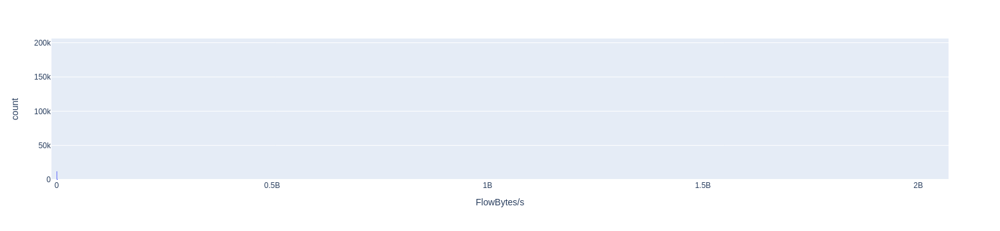

In [66]:
# https://plotly.com/python/statistical-charts/
fig = px.histogram(dados, x="FlowBytes/s")
fig.show()

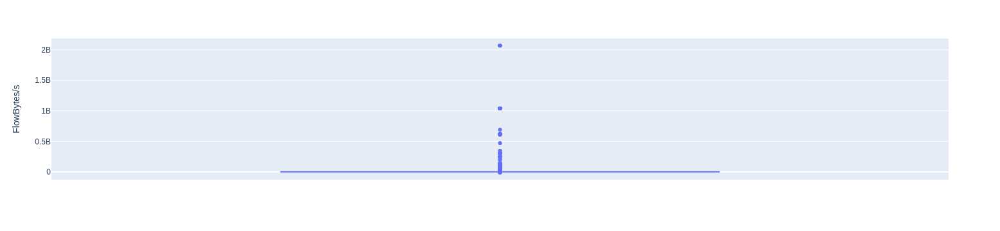

In [67]:
fig = px.box(dados, y="FlowBytes/s")
fig.show()

In [68]:
## Escolha outra variavel e mostre o histograma e o box-plot 

## Analises bivariadas

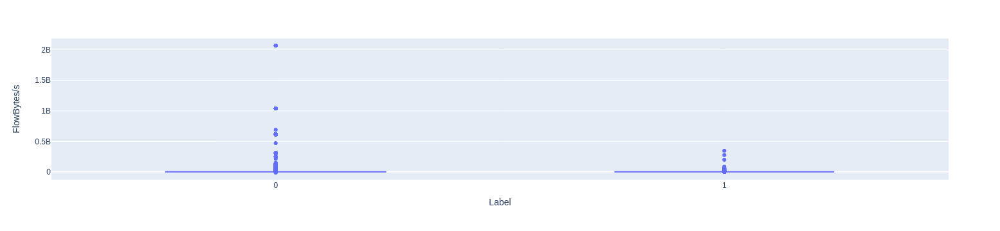

In [69]:
fig = px.box(dados, y="FlowBytes/s", x="Label")
fig.show()

In [70]:
## Escolha outra variavel e construa o box-plot com o x=Label 

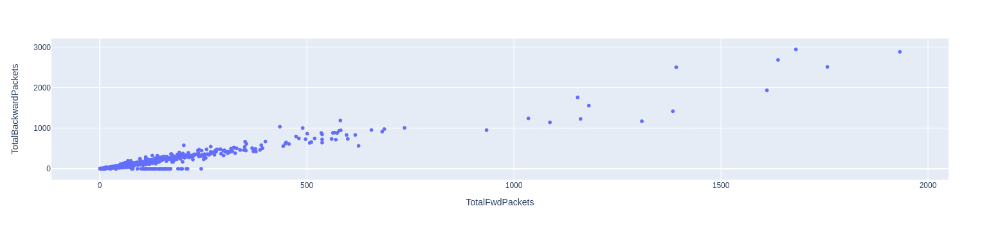

In [71]:
fig = px.scatter(dados, x="TotalFwdPackets", y="TotalBackwardPackets")
fig.show()

## Arrumar as variáveis

In [75]:
dados['FlowBytes/s'] = np.where(np.isnan(dados['FlowBytes/s']), 0, dados['FlowBytes/s'])
dados['FlowBytes/s'] = np.where(np.isinf(dados['FlowBytes/s']), 0, dados['FlowBytes/s'])

In [82]:
## arrumar a outra variavel 

In [77]:
verificarNaN(dados)

('DestinationPort', False)
('FlowDuration', False)
('TotalFwdPackets', False)
('TotalBackwardPackets', False)
('TotalLengthofFwdPackets', False)
('TotalLengthofBwdPackets', False)
('FwdPacketLengthMax', False)
('FwdPacketLengthMin', False)
('FwdPacketLengthMean', False)
('FwdPacketLengthStd', False)
('BwdPacketLengthMax', False)
('BwdPacketLengthMin', False)
('BwdPacketLengthMean', False)
('BwdPacketLengthStd', False)
('FlowBytes/s', False)
('FlowPackets/s', False)
('FlowIATMean', False)
('FlowIATStd', False)
('FlowIATMax', False)
('FlowIATMin', False)
('FwdIATTotal', False)
('FwdIATMean', False)
('FwdIATStd', False)
('FwdIATMax', False)
('FwdIATMin', False)
('BwdIATTotal', False)
('BwdIATMean', False)
('BwdIATStd', False)
('BwdIATMax', False)
('BwdIATMin', False)
('FwdPSHFlags', False)
('BwdPSHFlags', False)
('FwdURGFlags', False)
('BwdURGFlags', False)
('FwdHeaderLength', False)
('BwdHeaderLength', False)
('FwdPackets/s', False)
('BwdPackets/s', False)
('MinPacketLength', False)
('Ma

In [ ]:
verificarInf(dados)

## Analise de Correlação

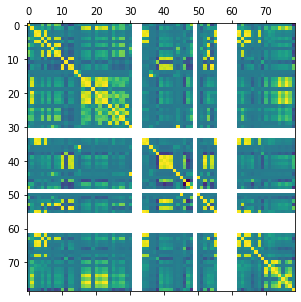

In [80]:
plt.matshow(dados.corr())
plt.show()

### Seleção de Variaveis
Tipos: 
- Manual
- Filter: São aplicados medidas estatísticas para ranquear as variáveis
- Wrapper: Analisa um conjunto de variáveis e suas combinações através da avaliação da acurácia dos modelos
- Embedded: Seleciona as variáveis enquanto o modelo está sendo treinado

In [96]:
X = dados.drop(["DestinationPort", "FlowDuration", "Label"], axis= 1)
y = dados["Label"]
X_train, X_val, y_train, y_val = train_test_split(X, y, random_state=42, test_size=0.7)

## Modelo 
- Modelo utilizado: RandomForest

In [100]:
model = RandomForestClassifier(n_estimators = 5, max_depth = 1, max_features = 5)

In [101]:
model.fit(X_train, y_train)

RandomForestClassifier(max_depth=1, max_features=5, n_estimators=5)

## Avaliação

![Matriz de confusão](matriz-confusao.png "Matriz confusão")

In [108]:
pred_train = model.predict(X_train)
pred_val = model.predict(X_val)
print(metrics.confusion_matrix(y_train, pred_train))
print(metrics.confusion_matrix(y_val, pred_val))

[[28399   882]
 [   63 38379]]
[[66353  2084]
 [  174 89411]]


![Curva ROC](Curva_ROC.svg.png "Curva ROC")

In [110]:
prob_train = model.predict_proba(X_train)[:,1]
prob_val = model.predict_proba(X_val)[:,1]
print(metrics.roc_auc_score(y_train, prob_train))
print(metrics.roc_auc_score(y_val, prob_val))

0.9956317939290148
0.9953192500416062


## Importancia das variaveis 

Text(0.5, 0, 'Random Forest Feature Importance')

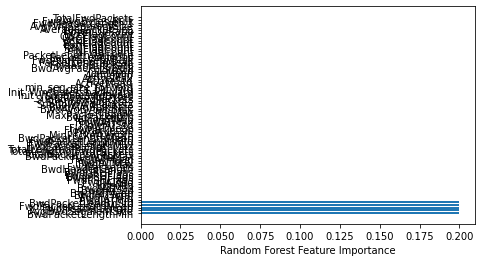

In [124]:
sorted_idx = model.feature_importances_.argsort()[::-1][:len(model.feature_importances_)]
plt.barh(model.feature_names_in_[sorted_idx], model.feature_importances_[sorted_idx])
plt.xlabel("Random Forest Feature Importance")

In [125]:
df_importance = pd.DataFrame()
df_importance["Nome"] = model.feature_names_in_[sorted_idx]
df_importance["Importancia"] = model.feature_importances_[sorted_idx]

In [128]:
df_importance

,Nome,Importancia
0,BwdPacketLengthMin,0.2
1,AvgBwdSegmentSize,0.2
2,FwdHeaderLength,0.2
3,FwdPacketLengthMean,0.2
4,BwdPacketLengthStd,0.2
5,BwdIATMin,0.0
6,FwdIATMin,0.0
7,BwdIATTotal,0.0
8,BwdIATMean,0.0
9,BwdIATStd,0.0


## Exercicios 
- 1) Removendo as 4 primeiras variaveis o modelo permanece com a mesma performance? 
- 2) Conseguimos diminuir o numero de variaveis a ponto de mantermos a mesma performance?
- 3) Varie os parametros do random forest e veja se melhora a performance? 

## Extra: 
Encontrar os hiperparametros dos modelos pode ser uma tarefa bastante complicada, quais estrategias voce usaria para encontrar os hiperparametros otimos?